In [ ]:
import librosa
from scipy.io import wavfile
import IPython

#name = './stedman9.wav'
#cambridge, sr = librosa.load(name)

name = '/Users/gfr/Google Drive/ny striking/STE-025.wav'
#name = '/Users/gfr/Google Drive/Strikeometer_NewHope/audio/GSM/gsm-ringing-10/2013_02_25_Practice-part6.wav'
sr, stedman = wavfile.read(name)
print(stedman.shape, sr)
stedman_left = stedman[:,0]/(32*1024.0)
stedman_right = stedman[:,1]/(32*1024.0)

alt, alt_sr = librosa.load(name)
IPython.display.Audio(data=alt, rate=alt_sr)


In [102]:
''' Load audio, compute spectrogram and nmf.'''
import matplotlib.pyplot as plt
from scipy import signal
import numpy as np
import librosa
import IPython
import math
from scipy import stats
from scipy import linalg
from sklearn.decomposition import NMF
from scipy.cluster.vq import whiten

def compute_nmf(clip1, sr, n, width, white=False):
  duration = len(clip1)/sr
  print(len(clip1), max(clip1))
  f, t, Sxx = signal.spectrogram(clip1, sr, mode='magnitude',
                                 nperseg=width, nfft=width, noverlap=width-width//8, scaling='density')
  print('frequency resolution is: ', f[1]-f[0])
  # scale by frequency, to get power per octave, or more radical scaling??
  # When scaled by f**3, we get a dramatic percussive signal.  This requires adding another NMF
  # component, that will emphasize the percussive element.  It's inconsistent, though, so probably
  # not worth the trouble.
  # Scaling by f**2, we get very nice definition of the bell spectra.
  Sxx = np.multiply(Sxx.T, np.arange(len(f))**2).T
  if sr == 48000: 
    Sxx = Sxx[:(3*len(f))//4,]
    f = f[:3*len(f)//4]
  if white: Sxx = whiten(Sxx.T).T
  fig = plt.figure(figsize=(100,5), dpi=120)
  plt.imshow(np.log(Sxx), origin='lower', aspect='auto', extent=[0,t[-1],0,f[-1]])
  plt.show()

  print('Sxx shape', Sxx.shape)
  norm = linalg.norm(Sxx)

  nmf = NMF(n_components=n, max_iter=10, tol=1e-3, alpha=100)
  W = nmf.fit_transform(Sxx.T)
  H = nmf.components_
  print('iters: ', nmf.n_iter_, 'nmf error: ', nmf.reconstruction_err_/norm)
  fig = plt.figure(figsize=(50,5), dpi=120)
  plt.plot(f, nmf.components_.T)
  plt.show()
  nmf = NMF(init='custom', n_components=n, max_iter=10, tol=1e-3, alpha=100)

  for i in range(5):
    W = nmf.fit_transform(Sxx.T, W=W, H=H)
    print('iters: ', nmf.n_iter_, 'nmf error: ', nmf.reconstruction_err_/norm)
    fig = plt.figure(figsize=(50,5), dpi=120)
    plt.plot(f, nmf.components_.T)
    plt.show()

  print('nmf shape: ', nmf.components_.shape, ' iters: ', nmf.n_iter_,
        'nmf error: ', nmf.reconstruction_err_/norm)
  fig = plt.figure(figsize=(50,5), dpi=120)
  plt.plot(f, nmf.components_.T)
  plt.show()

  return t, nmf, W


In [ ]:


# TODO - collapse H by 4x and use to seed the lower resolution.
t2048, nmf2048, trans2048 = compute_nmf(cambridge, sr, 11, 2048)
t512, nmf512, trans512 = compute_nmf(cambridge, sr, 11, 512)
#nmf256, trans256 = compute_nmf(cambridge, sr, 11, 256)

IPython.display.Audio(data=cambridge, rate=sr)


(2000000, 0.664825439453125)
('frequency resolution is: ', 93.75)


/opt/intel/intelpython27/lib/python2.7/site-packages/ipykernel/__main__.py:30: RuntimeWarning: divide by zero encountered in log


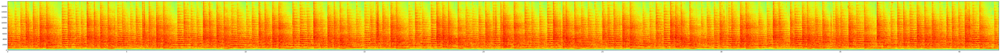

('Sxx shape', (192, 31243))
('iters: ', 9, 'nmf error: ', 0.43555226194046726)


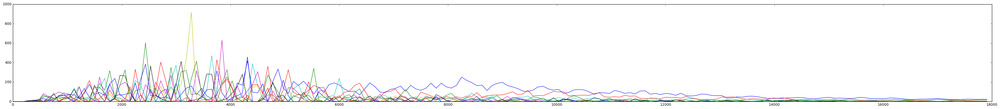

('iters: ', 9, 'nmf error: ', 0.43038067328463814)


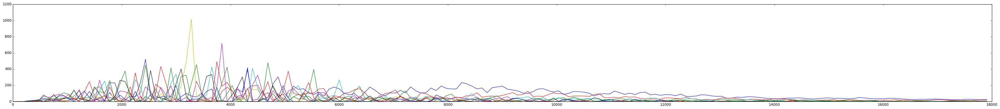

('iters: ', 9, 'nmf error: ', 0.42894913373958105)


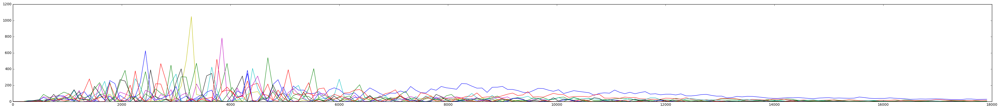

('iters: ', 9, 'nmf error: ', 0.42809704777992996)


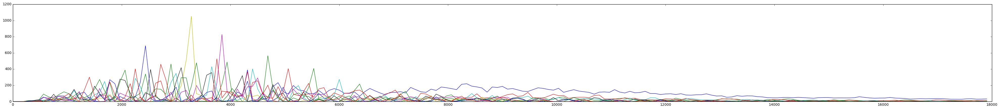

('iters: ', 9, 'nmf error: ', 0.42760371552145587)


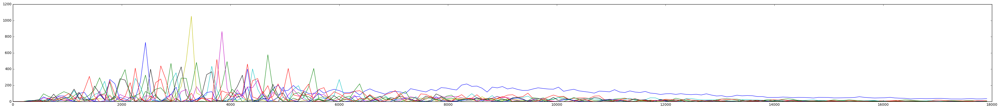

('iters: ', 9, 'nmf error: ', 0.42737358022249256)


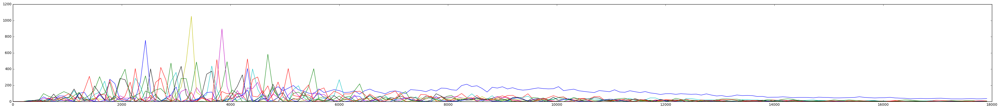

('nmf shape: ', (10, 192), ' iters: ', 9, 'nmf error: ', 0.42737358022249256)


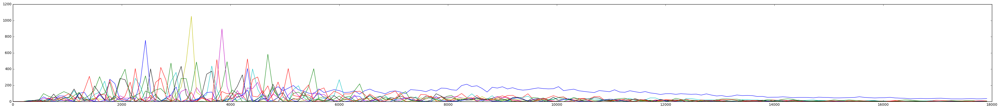

In [103]:

t512L, nmf512L, trans512L = compute_nmf(stedman_left[2000000:4000000], sr, 10, 512)


In [88]:
t512Lw, nmf512Lw, trans512Lw = compute_nmf(stedman_left[2000000:5000000], sr, 11, 512, True)
t512Rw, nmf512Rw, trans512Rw = compute_nmf(stedman_right[2000000:5000000], sr, 11, 512, True)


(3000000, 0.68011474609375)
('frequency resolution is: ', 93.75)


ValueError: only 1-dimensional arrays can be used

(21529280, 0.817626953125)
('frequency resolution is: ', 93.75)


/opt/intel/intelpython27/lib/python2.7/site-packages/ipykernel/__main__.py:30: RuntimeWarning: divide by zero encountered in log


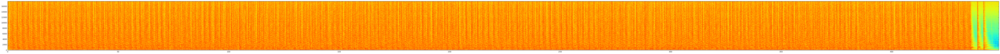

('Sxx shape', (192, 336388))
('iters: ', 9, 'nmf error: ', 0.46367713975182451)


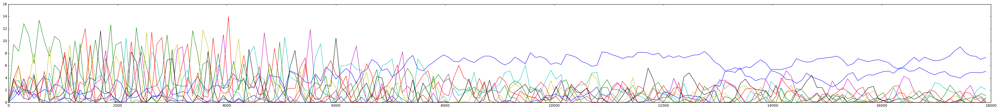

('iters: ', 9, 'nmf error: ', 0.46179172345781577)


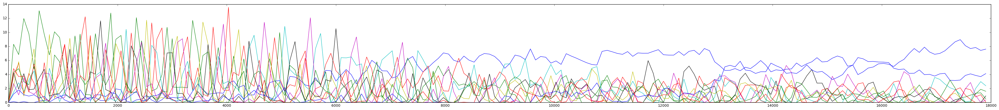

('iters: ', 9, 'nmf error: ', 0.4613868039412255)


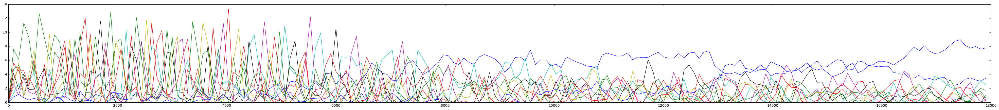

('iters: ', 9, 'nmf error: ', 0.46124008767629071)


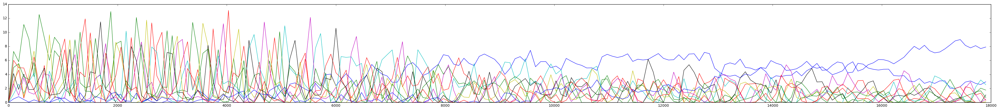

('iters: ', 9, 'nmf error: ', 0.46116475699842768)


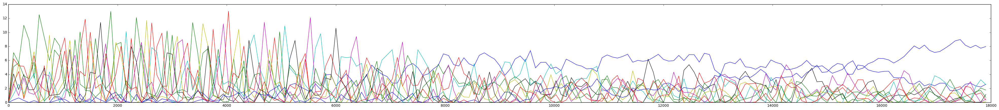

('iters: ', 9, 'nmf error: ', 0.46112318988377554)


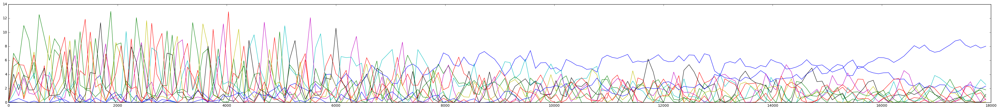

('nmf shape: ', (10, 192), ' iters: ', 9, 'nmf error: ', 0.46112318988377554)


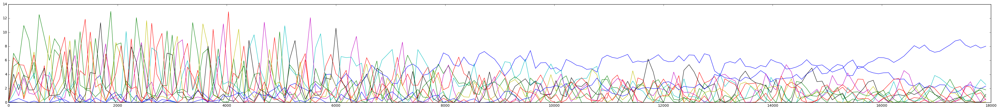

(21529280, 0.76153564453125)
('frequency resolution is: ', 93.75)


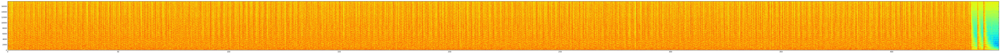

('Sxx shape', (192, 336388))
('iters: ', 9, 'nmf error: ', 0.46749699238264131)


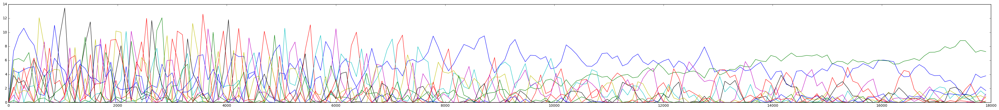

('iters: ', 9, 'nmf error: ', 0.46340335280515316)


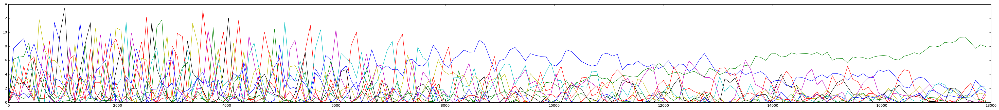

('iters: ', 9, 'nmf error: ', 0.4621379472206032)


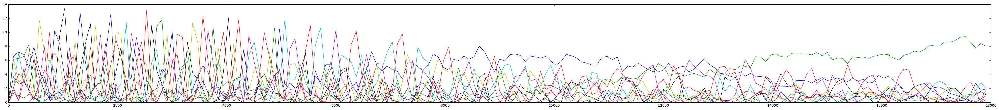

('iters: ', 9, 'nmf error: ', 0.46186565044805783)


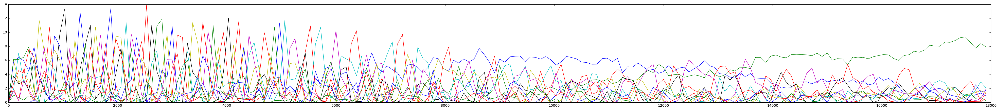

('iters: ', 9, 'nmf error: ', 0.46179301884283586)


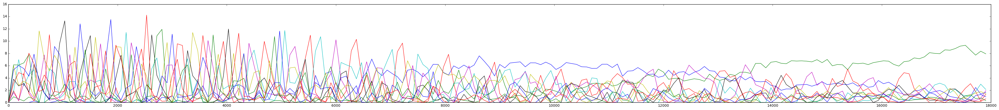

('iters: ', 9, 'nmf error: ', 0.46176611023267106)


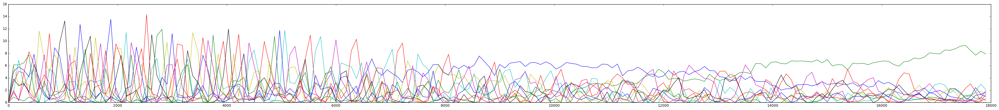

('nmf shape: ', (10, 192), ' iters: ', 9, 'nmf error: ', 0.46176611023267106)


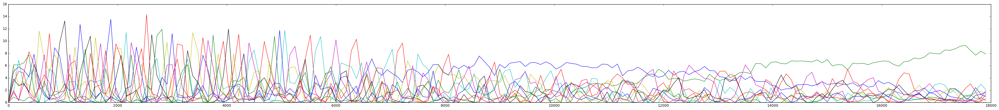

In [104]:
t512Lw, nmf512Lw, trans512Lw = compute_nmf(stedman_left, sr, 10, 512, True)
t512Rw, nmf512Rw, trans512Rw = compute_nmf(stedman_right, sr, 10, 512, True)


In [ ]:
# matched filter?
# If the filter is properly matched, the peaks should be symmetric.
# We may want to refine the filter after initial detection.

def check(c, t):
    delta = np.asarray(c[1:])-np.asarray(c[:-1])
    median = np.median(delta)
    delta = delta - median
    tooShort = delta < -.3 * median
    short = [i for (i, v) in zip(range(len(tooShort)), tooShort) if v]
    if len(short): print('too short', t[short])
    tooLong = delta > .3 * median
    long = [i for (i, v) in zip(range(len(tooLong)), tooLong) if v]
    if len(long): print('too long', t[long])
    print(median, tooShort.sum(), tooLong.sum(), len(c))

    return tooShort, tooLong

# matched filter
def mf(w):
    ''' Approximate a matched filter for a bell power signal as a quadratic followed by steep edge.
    Args:  w - the width of the filter in frames.  The half power width is roughly .7 * width.
    '''
    eighth = w**2/8
    f = np.append(np.arange(1,w+1)**2, (7 - np.arange(7))*eighth)
    f = f/(1.0*np.sum(f))
    return f

from sortedcontainers import SortedList

def argrelmax(x, order, minval):
    '''argrelmax is similar to signal.argrelmax, but much much faster
    Args: x - the 1D array to search for local max values
          order - the half width of the local region
          minval - the minimum value that may be considered a peak
    '''
    sort = np.argsort(x)[::-1]  # These are indices into x, largest to smallest x value
    xx = SortedList([-order,len(x)+order+1])
    peaks = SortedList([-order,len(x)+order+1])  # We'll strip the ends when finished
    for t in sort:
        if x[t] < minval: break
        test = xx.bisect(t)
        xx.insert(test, t)
        if xx[test-1]+order < xx[test] and xx[test] < xx[test+1]-order:
            i = peaks.bisect(t)
            peaks.insert(i,t)
    return peaks[1:-1]        

def show_results(t, trans, order):
  print('512, matched filter')
  fps = sr/(512/8.0)
  print(fps, ' frames per second.  Frame length (msec)', (100000//fps)/100.0)

  # matched filter
  filt = mf(700)

  fig = plt.figure(figsize=(10,2), dpi=120)
  time = t[:len(filt)]
  plt.plot(time, filt)
  plt.show()

  lpz = signal.convolve2d(trans, filt.reshape(len(filt),1), mode='same')
  # normalize on 90th percentile, such that signal is greater than 1 about 10% of the period.
  z = lpz/np.percentile(lpz, q=90, axis=0)

  peaks = []
  for r in z.T[order,]:
    p = np.array(argrelmax(r, int(fps), 0.5))
    check(p, t)
    peaks.append(p)

  print('time ', t[-1])
  stagger = np.arange(len(order)).reshape(1,len(order))
  # plot 10 second intervals
  for t0 in range(0, int(t[-1]), 10):
    start = int(t0*fps)
    end = min(int((t0+10)*fps - 1), z.shape[0]-1)
    fig = plt.figure(figsize=(10,2), dpi=120)
    plt.plot(t[start:end], z[start:end,order] + stagger, ',')
    # Find the corresponding peaks from list of lists.
    for i in range(len(order)):
        o = order[i]
        x = z.T[o]
        pp = peaks[i]
        for p in pp:
            if p >= start and p < end:
                plt.plot(t[p], i + x[p], 'r+')
        
    plt.show()

show_results(t512Lw, trans512Lw, [0,1,2,3,4,5,6,7,8,9])

512, matched filter
(750.0, ' frames per second.  Frame length (msec)', 1.33)


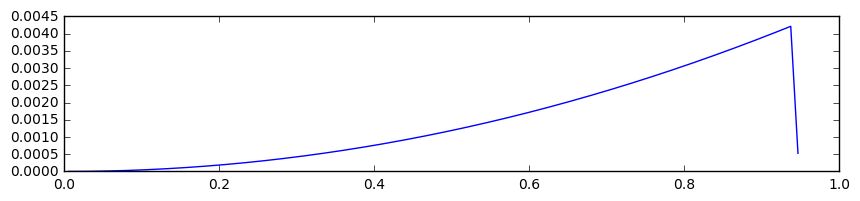

('too short', array([ 0.01866667,  0.04533333,  0.04666667,  0.06266667,  0.068     ,
        0.07466667,  0.08266667,  0.08533333,  0.088     ,  0.09866667,
        0.104     ,  0.108     ,  0.11066667,  0.124     ,  0.12666667,
        0.13066667,  0.14533333,  0.148     ,  0.14933333,  0.17066667,
        0.17466667,  0.17866667,  0.18      ,  0.18666667,  0.196     ,
        0.20666667,  0.21066667,  0.21333333,  0.216     ,  0.21733333,
        0.22666667,  0.22933333,  0.23066667,  0.23333333,  0.236     ,
        0.23866667,  0.24133333,  0.24266667,  0.24666667,  0.24933333,
        0.252     ,  0.25466667]))
('too long', array([ 0.00533333,  0.01066667,  0.01333333,  0.016     ,  0.02266667,
        0.02533333,  0.028     ,  0.03333333,  0.036     ,  0.03866667,
        0.04133333,  0.044     ,  0.05066667,  0.05333333,  0.06533333,
        0.06933333,  0.08933333,  0.09066667,  0.09333333,  0.1       ,
        0.11733333,  0.12      ,  0.13733333,  0.14266667,  0.14666667,
  

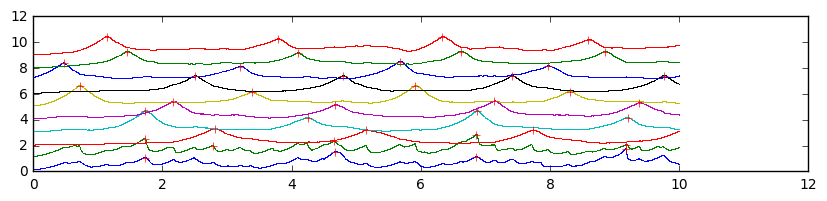

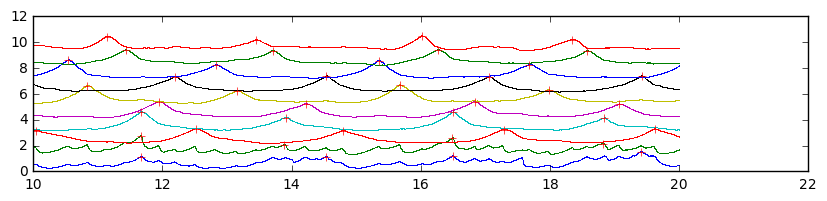

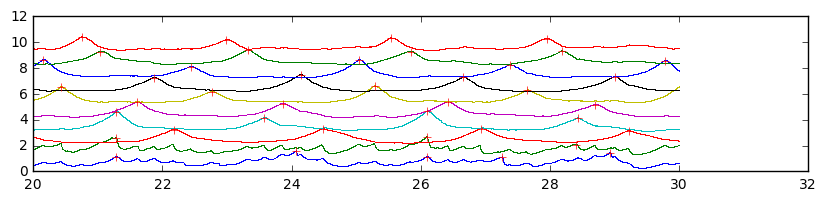

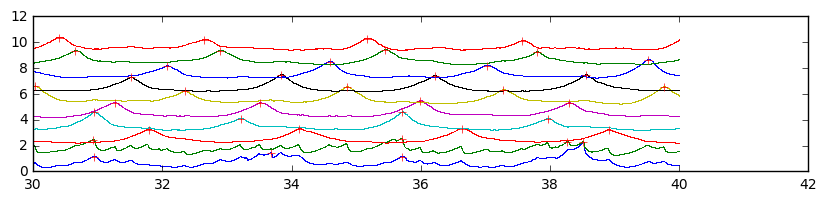

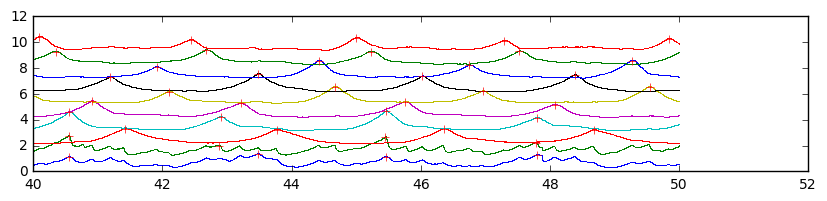

...

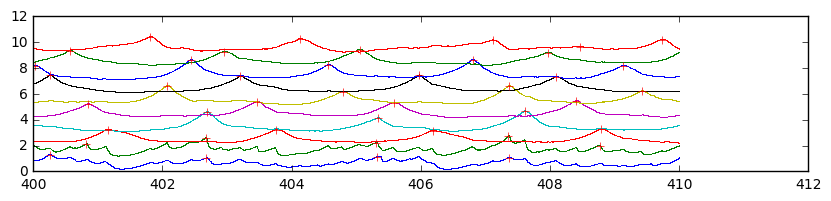

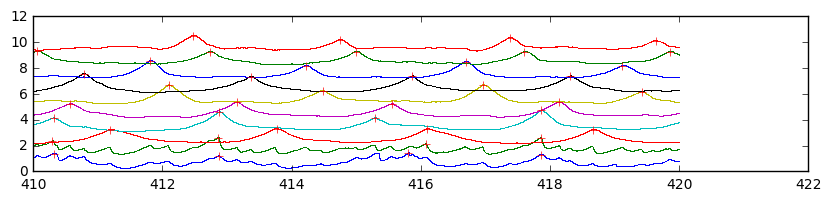

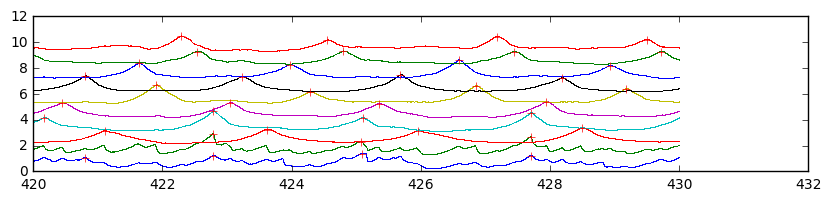

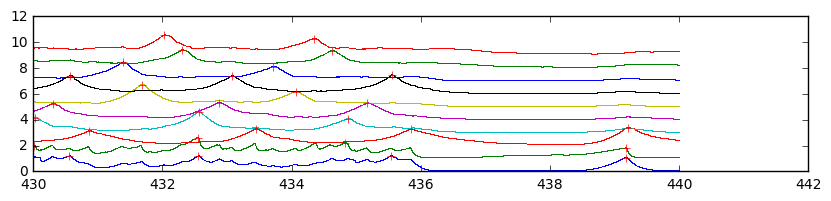

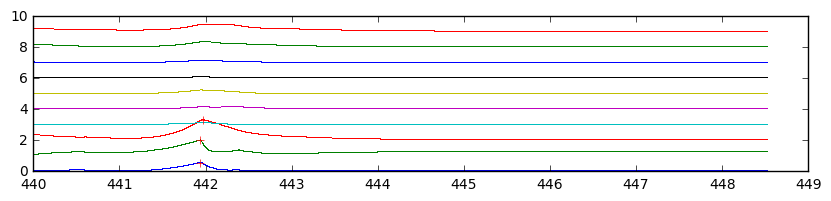

512, matched filter
(750.0, ' frames per second.  Frame length (msec)', 1.33)


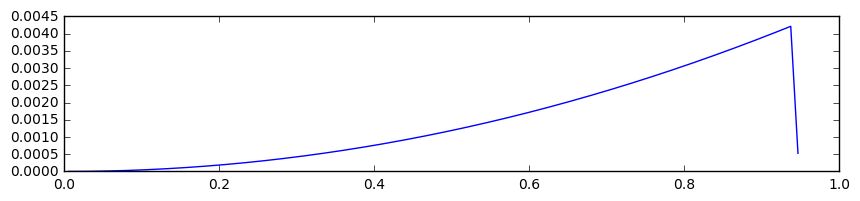

('too short', array([ 0.00666667,  0.00933333,  0.02933333,  0.036     ,  0.03866667,
        0.04      ,  0.04266667,  0.044     ,  0.04666667,  0.048     ,
        0.05066667,  0.05333333,  0.06533333,  0.084     ,  0.08533333,
        0.08666667,  0.088     ,  0.1       ,  0.116     ,  0.11866667,
        0.12      ,  0.12266667,  0.12533333,  0.128     ,  0.13066667,
        0.132     ,  0.13466667,  0.13733333,  0.14933333,  0.15466667,
        0.16666667,  0.17066667,  0.172     ,  0.17333333,  0.17866667,
        0.18      ,  0.184     ,  0.192     ,  0.196     ,  0.19733333,
        0.20533333,  0.20666667,  0.21333333,  0.21733333,  0.22133333,
        0.23733333,  0.24666667,  0.26133333,  0.26266667,  0.26533333,
        0.268     ]))
('too long', array([ 0.008     ,  0.01733333,  0.02      ,  0.02133333,  0.02533333,
        0.02666667,  0.028     ,  0.03066667,  0.03333333,  0.03466667,
        0.03733333,  0.04933333,  0.05733333,  0.06      ,  0.06133333,
        0.06933

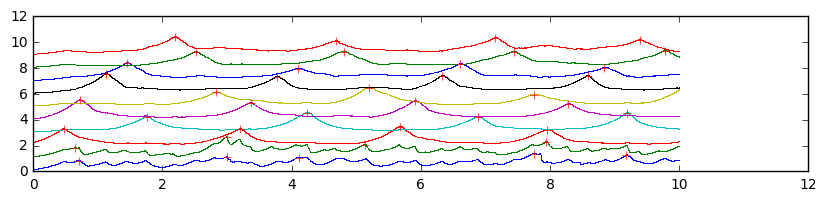

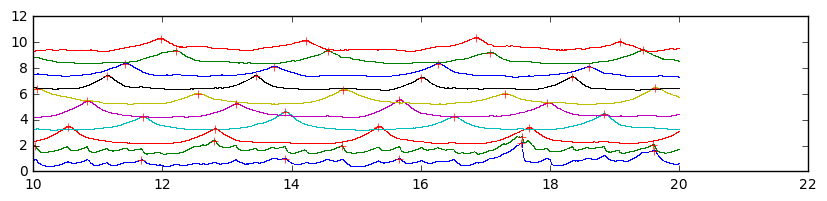

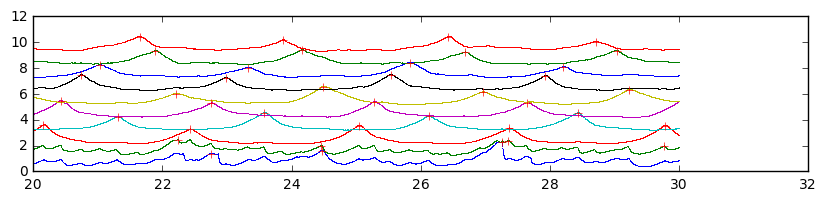

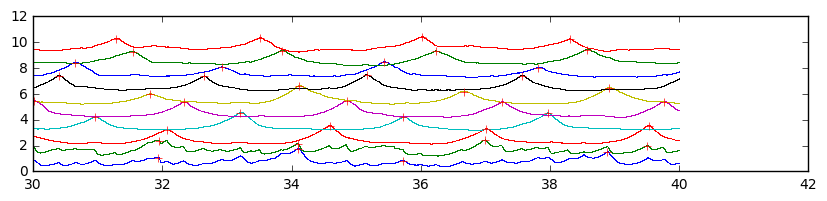

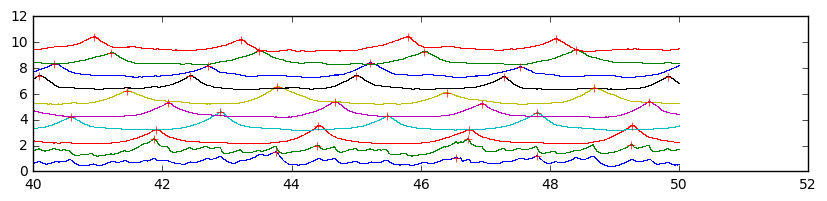

...

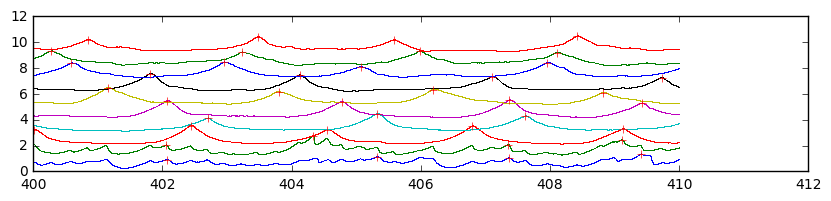

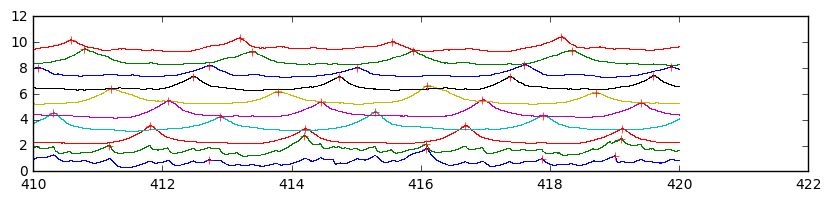

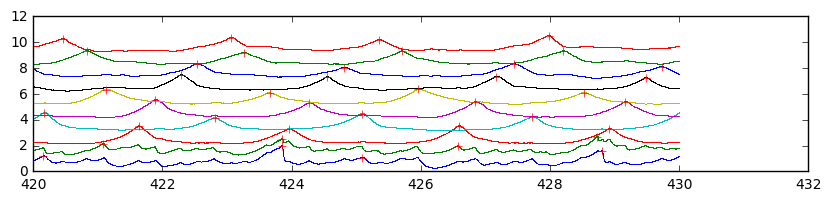

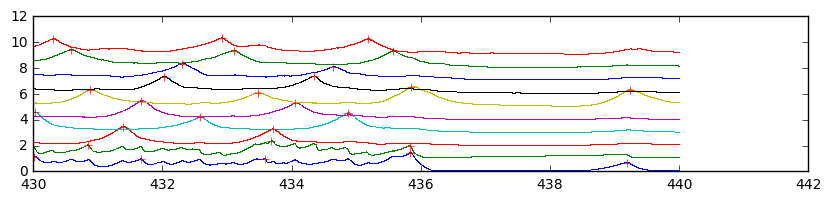

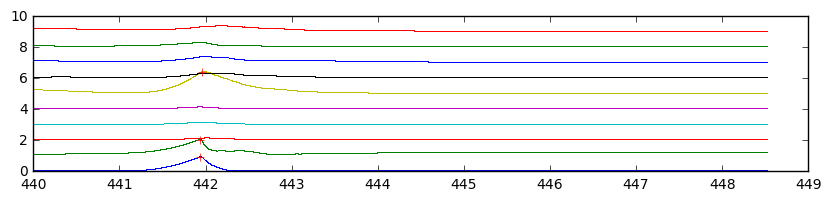

In [105]:
show_results(t512Lw, trans512Lw, [0,7,1,3,5,6,2,4,8,9])
show_results(t512Rw, trans512Rw, [0,1,2,3,4,5,6,7,8,9])

In [ ]:
from sortedcontainers import SortedList

'''Idea - instead of argrelmax, what if we argsort, then populate a list of selected max values'''
def argrelmax(x, order, minval):
    '''argrelmax is similar to signal.argrelmax, but much much faster
    Args: x - the 1D array to search for local max values
          order - the half width of the local region
          minval - the minimum value that may be considered a peak
    '''
    sort = np.argsort(x)[::-1]  # These are indices into x, largest to smallest x value
    print(x)
    print(np.array(x)[sort])
    xx = SortedList([-order,len(x)+order+1])
    peaks = SortedList([-order,len(x)+order+1])  # We'll strip the ends when finished
    for t in sort:
        if x[t] < minval: break
        test = xx.bisect(t)
        xx.insert(test, t)
        if xx[test-1]+order < xx[test] and xx[test] < xx[test+1]-order:
            i = peaks.bisect(t)
            print('insert', i, t, x[t])
            peaks.insert(i,t)
        else:
            print('skip', i, t, x[t])
    return peaks[1:-1]
        
     
x = [1,2,3,6,9,3,1,10,5,3,1,3,8,6,3,1,2,5,6,5,4,3,2,2,3,4,5,4,3,2,1]
p = argrelmax(x, 4, 3)
print(p)
print(np.array(x)[p[:]])
    

